In [1]:
import os
import pandas as pd
import glob
import plotly.express as px
from MCForecastTools import MCSimulation
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models, expected_returns, objective_functions
from pypfopt.discrete_allocation import DiscreteAllocation, get_latest_prices
from pypfopt.expected_returns import mean_historical_return
from pypfopt.risk_models import CovarianceShrinkage

In [2]:
        
path = '.\\coin_csvs\\'
all_files = glob.glob(path + "/*.csv")

lst = []
tickers=[]
for filename in all_files:
	if filename.replace(path,"").find('t') == 0:
		df = pd.read_csv(filename, index_col='date')
		lst.append(df)
		temp=filename.replace(path,"")
		temp=temp.removeprefix('t')
		temp=temp.removesuffix('.csv')
		tickers.append(temp)
	
df_ticker = pd.concat(lst, axis=1, keys=tickers)
df_ticker.sort_index(ascending=True,inplace=True)



In [3]:
df_ticker

1INCHUSD                                                          \
              close     high      low           mts     open         volume   
date                                                                          
2013-03-31      NaN      NaN      NaN           NaN      NaN            NaN   
2013-04-01      NaN      NaN      NaN           NaN      NaN            NaN   
2013-04-02      NaN      NaN      NaN           NaN      NaN            NaN   
2013-04-03      NaN      NaN      NaN           NaN      NaN            NaN   
2013-04-04      NaN      NaN      NaN           NaN      NaN            NaN   
...             ...      ...      ...           ...      ...            ...   
2024-02-21  0.43520  0.44614  0.41997  1.708474e+12  0.44598   13402.886834   
2024-02-22  0.44303  0.45214  0.42935  1.708560e+12  0.43447    8231.898463   
2024-02-23  0.47180  0.49445  0.43274  1.708646e+12  0.44390   49148.019694   
2024-02-24  0.49458  0.55557  0.46510  1.708733e+12  0.47028  603065.025076   
2024-02-25  0.49235  0.49719  0.47773  1.708819e+12  0.49416   12393.444930   

            AAVEUSD                                 ...    ZILUSD  \
              close     high     low           mts  ...       low   
date                                                ...             
2013-03-31      NaN      NaN     NaN           NaN  ...       NaN   
2013-04-01      NaN      NaN     NaN           NaN  ...       NaN   
2013-04-02      NaN      NaN     NaN           NaN  ...       NaN   
2013-04-03      NaN      NaN     NaN           NaN  ...       NaN   
2013-04-04      NaN      NaN     NaN           NaN  ...       NaN   
...             ...      ...     ...           ...  ...       ...   
2024-02-21   91.755   93.900  88.128  1.708474e+12  ...  0.022280   
2024-02-22   91.902   93.801  90.228  1.708560e+12  ...  0.021580   
2024-02-23   95.148  101.700  89.510  1.708646e+12  ...  0.022845   
2024-02-24  101.480  103.960  94.484  1.708733e+12  ...  0.022646   
2024-02-25   99.272  101.640  97.720  1.708819e+12  ...  0.022000   

                                                    ZRXUSD                    \
                     mts      open         volume    close     high      low   
date                                                                           
2013-03-31           NaN       NaN            NaN      NaN      NaN      NaN   
2013-04-01           NaN       NaN            NaN      NaN      NaN      NaN   
2013-04-02           NaN       NaN            NaN      NaN      NaN      NaN   
2013-04-03           NaN       NaN            NaN      NaN      NaN      NaN   
2013-04-04           NaN       NaN            NaN      NaN      NaN      NaN   
...                  ...       ...            ...      ...      ...      ...   
2024-02-21  1.708474e+12  0.023450   49996.938353  0.35126  0.36731  0.33460   
2024-02-22  1.708560e+12  0.022700  340957.892966  0.35238  0.36109  0.34252   
2024-02-23  1.708646e+12  0.022845    8502.000000  0.35147  0.36267  0.34433   
2024-02-24  1.708733e+12  0.022646   35563.477207  0.36208  0.37666  0.34430   
2024-02-25  1.708819e+12  0.024084  507350.026576  0.36274  0.36527  0.35512   

                                                  
                     mts     open         volume  
date                                              
2013-03-31           NaN      NaN            NaN  
2013-04-01           NaN      NaN            NaN  
2013-04-02           NaN      NaN            NaN  
2013-04-03           NaN      NaN            NaN  
2013-04-04           NaN      NaN            NaN  
...                  ...      ...            ...  
2024-02-21  1.708474e+12  0.36731   40623.336044  
2024-02-22  1.708560e+12  0.35207  224696.433792  
2024-02-23  1.708646e+12  0.35339  637869.379350  
2024-02-24  1.708733e+12  0.35194  487277.809943  
2024-02-25  1.708819e+12  0.36271   83755.213565  

[3977 rows x 1116 columns]

In [4]:
# Set the plotting backend to Plotly
pd.options.plotting.backend = "plotly"


fig=df_ticker.xs('close',axis=1,level=1).plot.line(title='Log10 Graph of All USD Cryptocoins - '+str(len(tickers)),log_y=True)
fig.update_traces(showlegend=False)
# show figure
fig.show()
# save image of figure
fig.update_layout(
margin=dict(l=20, r=20, t=30, b=20),
)
fig.write_image('./log10_all.png', format = 'png', width = 400, height = 400, scale = 1, engine = 'kaleido')

In [5]:
returns={}
for each in df_ticker.columns.levels[0]:
    ticker_return=((df_ticker[each]['close'].pct_change()+1).cumprod()-1)[-1]
    returns[each]=ticker_return
returns
fig=px.histogram(x=returns.values(),title='Histogram of All USD Cryptocoins - '+str(len(returns)))
fig.update_layout(
    yaxis_title='Count',  # Specify your desired x-axis label here
    xaxis_title='Current Return from inception'
    )# show figure
fig.show()
# save image of figure
fig.write_image('./hist_all.png', format = 'png', width = 500, height = 500, scale = 1, engine = 'kaleido')

C:\Users\jason\AppData\Local\Temp\ipykernel_49444\1613908039.py:3: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\jason\AppData\Local\Temp\ipykernel_49444\1613908039.py:3: FutureWarning:

The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



In [6]:
returns

{'1INCHUSD': -0.9239214413746215,
 'AAVEUSD': -0.8040581083214898,
 'ADAUSD': 3.065840757238293,
 'ALGUSD': -0.942355742296919,
 'AMPUSD': -0.07125122263185901,
 'APENFTUSD': -0.6000000000000015,
 'APEUSD': -0.7865362418533073,
 'APPUSD': -0.23728643719625198,
 'APTUSD': 0.31599005573161487,
 'ARBUSD': 0.39966969446738143,
 'ATOUSD': 2.1882352941176384,
 'AVAXUSD': 9.485033180484763,
 'AXSUSD': -0.839328389367159,
 'B2MUSD': -0.7144592145015105,
 'BALUSD': -0.7124440630172248,
 'BANDUSD': -0.6898932458315379,
 'BATUSD': -0.7010790114862497,
 'BCHNUSD': 0.10860384233189535,
 'BESTUSD': -0.534616161616162,
 'BGBUSD': 1.4668084794249223,
 'BLURUSD': -0.043416458852868045,
 'BMNUSD': -0.15624999999999978,
 'BOBAUSD': -0.94845374617737,
 'BONKUSD': -0.4049586776859504,
 'BORGUSD': 0.0997584275831771,
 'BOSONUSD': -0.9528434467888496,
 'BTCUSD': 552.728246966125,
 'BTTUSD': -0.9999459595959596,
 'CCDUSD': -0.9463381878433768,
 'CELOUSD': 0.1941580982801634,
 'CHEXUSD': 1.2322699953767962,
 '

In [7]:
good_coins=[]
for each in returns:
    if (returns[each] > 1):
        good_coins.append(each)
print(len(good_coins))
print(good_coins)
df_ticker[good_coins].to_csv('good_coins.csv')

for each in good_coins:
    if "TEST" in each:
        good_coins.remove(each)
for each in good_coins:
    if "TEST" in each:
        good_coins.remove(each)
for each in good_coins:
    if "TEST" in each:
        good_coins.remove(each)
for each in good_coins:
    if "TEST" in each:
        good_coins.remove(each)
print(len(good_coins))
print(good_coins)

34
['ADAUSD', 'ATOUSD', 'AVAXUSD', 'BGBUSD', 'BTCUSD', 'CHEXUSD', 'CHZUSD', 'EGLDUSD', 'ETCUSD', 'ETH2XUSD', 'ETHUSD', 'FETUSD', 'GNOUSD', 'GTXUSD', 'KARATEUSD', 'LEOUSD', 'LTCUSD', 'MNAUSD', 'OPXUSD', 'PNKUSD', 'RRTUSD', 'SEIUSD', 'SOLUSD', 'TESTAVAXTESTUSD', 'TESTBTCTESTUSD', 'TESTBTCTESTUSDT', 'TESTSOLTESTUSD', 'TIAUSD', 'TRADEUSD', 'UOSUSD', 'VETUSD', 'WBTUSD', 'XDCUSD', 'XMRUSD']
30
['ADAUSD', 'ATOUSD', 'AVAXUSD', 'BGBUSD', 'BTCUSD', 'CHEXUSD', 'CHZUSD', 'EGLDUSD', 'ETCUSD', 'ETH2XUSD', 'ETHUSD', 'FETUSD', 'GNOUSD', 'GTXUSD', 'KARATEUSD', 'LEOUSD', 'LTCUSD', 'MNAUSD', 'OPXUSD', 'PNKUSD', 'RRTUSD', 'SEIUSD', 'SOLUSD', 'TIAUSD', 'TRADEUSD', 'UOSUSD', 'VETUSD', 'WBTUSD', 'XDCUSD', 'XMRUSD']


In [16]:
fig=df_ticker[good_coins].xs('close',axis=1,level=1).plot.line(title='Log10 Graph of Positive Return USD Cryptocoins - '+str(len(good_coins)),log_y=True)
fig.update_traces(showlegend=False)
# show figure
fig.show()
# save image of figure
fig.write_image('./log10_good.png', format = 'png', width = 1000, height = 500, scale = 1, engine = 'kaleido')

In [17]:
fig=px.histogram(x=((df_ticker[good_coins].xs('close',axis=1,level=1).pct_change()+1).cumprod()-1).iloc[-1,:],title='Histogram of All Positive-Return USD Cryptocoins - '+str(len(good_coins)),text_auto=True)
fig.update_layout(
    yaxis_title='Count',  # Specify your desired x-axis label here
    xaxis_title='Current Return from inception'
    )
# show figure
fig.show()
# save image of figure
fig.write_image('./hist_pos_return.png', format = 'png', width = 500, height = 500, scale = 1, engine = 'kaleido')

C:\Users\jason\AppData\Local\Temp\ipykernel_11192\782111260.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



In [18]:

# # Set number of simulations
# num_sims = 100
# years = 5

# #create DataFrame for capturing ticker MC simulation statistics
# final_mean_median=pd.DataFrame(columns=['ticker','mean','median'])
# final_mean_median.set_index('ticker',inplace=True)


# for each in good_coins:
#     print(each)
#     ticker_data=df_ticker.loc[:, ([each], ['open','high','close','volume'])]

#     # Configure a Monte Carlo simulation to forecast X years daily returns

#     MC_ticker = MCSimulation(
#         portfolio_data = ticker_data,
#         num_simulation = num_sims,
#         num_trading_days = 252*years
#     )

#     MC_ticker.calc_cumulative_return()
#     # Compute summary statistics from the simulated daily returns
#     simulated_returns_data = {
#         "mean": list(MC_ticker.simulated_return.mean(axis=1)),
#         "median": list(MC_ticker.simulated_return.median(axis=1)),
#         "min": list(MC_ticker.simulated_return.min(axis=1)),
#         "max": list(MC_ticker.simulated_return.max(axis=1))
#     }

#     # Store endpoint mean and median in a dataframe for later screening
#     final_mean_median.loc[each]=[simulated_returns_data['mean'][-1],simulated_returns_data['median'][-1]]
    
#     # Create a DataFrame with the summary statistics
#     df_simulated_returns = pd.DataFrame(simulated_returns_data)

#     # Display sample data
#     df_simulated_returns.head()

#     # Plot simulation outcomes
#     line_plot = MC_ticker.plot_simulation()

#     # Save the plot for future usage
#     line_plot.get_figure().savefig(".\\monte_carlo_plots\\"+each+"_ten_year_sim_plot.png", bbox_inches="tight")

#     # Plot Return Behaviors
#     mean_median=df_simulated_returns[['mean', 'median']].plot(title="Simulated Cumulative Return Behavior of "+each+" Over the Next Ten Years")

#     #Save the plot
#     mean_median.get_figure().savefig(".\\mean_median_plots\\"+each+"_mean_median_sim_plot.png", bbox_inches="tight")

In [19]:
# old keepers

# Calculate mean/median as rough evaluation of non-Gaussian
final_mean_median['mean_div_median']=final_mean_median['mean']/final_mean_median['median']
final_mean_median=final_mean_median.sort_values(by='mean_div_median')

#
keepers = list(final_mean_median[(final_mean_median['mean_div_median']>1.05)].index)[:10]
keepers.append('BTCUSD')
keepers.append('ETHUSD')
len(keepers)

3

In [20]:
keepers=good_coins
print(keepers)
#keepers=['BGBUSD','BTCUSD','ETCUSD','ETHUSD','JSTUSD','LDOUSD','LINKUSD','MKRUSD','MNAUSD','OCEANUSD','XDCUSD','XMRUSD']
df = df_ticker.loc[:, (keepers, ['close'])]
# df.columns=df_ticker.columns.get_level_values(0)
df.columns=df.columns.droplevel(1)
df

['ADAUSD', 'ATOUSD', 'AVAXUSD', 'BGBUSD', 'BTCUSD', 'CHEXUSD', 'CHZUSD', 'EGLDUSD', 'ETCUSD', 'ETH2XUSD', 'ETHUSD', 'FETUSD', 'GNOUSD', 'GTXUSD', 'KARATEUSD', 'LEOUSD', 'LTCUSD', 'MNAUSD', 'OPXUSD', 'PNKUSD', 'RRTUSD', 'SEIUSD', 'SOLUSD', 'TIAUSD', 'TRADEUSD', 'UOSUSD', 'VETUSD', 'WBTUSD', 'XDCUSD', 'XMRUSD']


,ADAUSD,ATOUSD,AVAXUSD,BGBUSD,BTCUSD,CHEXUSD,CHZUSD,EGLDUSD,ETCUSD,ETH2XUSD,...,RRTUSD,SEIUSD,SOLUSD,TIAUSD,TRADEUSD,UOSUSD,VETUSD,WBTUSD,XDCUSD,XMRUSD
date,,,,,,,,,,,,,,,,,,,,,
2013-03-31,NaN,NaN,NaN,NaN,93.033000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-04-01,NaN,NaN,NaN,NaN,103.999000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-04-02,NaN,NaN,NaN,NaN,118.229354,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-04-03,NaN,NaN,NaN,NaN,134.700000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-04-04,NaN,NaN,NaN,NaN,132.899000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-21,0.59871,9.9955,37.601,0.94689,51859.000000,0.096303,0.11947,57.710,26.073,2979.9,...,0.77,0.87424,105.060,17.368,0.92175,0.17445,0.043353,51653.0,0.041580,123.10
2024-02-22,0.58451,9.7966,36.768,1.01370,51280.000000,0.094830,0.12750,57.467,25.813,2971.4,...,NaN,0.84396,101.690,16.933,0.96455,0.22402,0.045014,51041.0,0.041684,123.97
2024-02-23,0.58269,9.9857,35.967,1.01870,50737.000000,0.096439,0.12407,56.268,25.469,2927.6,...,NaN,0.78727,99.847,16.426,0.93105,0.21287,0.043500,50749.0,0.040890,123.77


In [21]:
# Utilizing the PyPortfolioOpt module
#https://pyportfolioopt.readthedocs.io/en/latest/UserGuide.html

mu = mean_historical_return(df)
S = CovarianceShrinkage(df).ledoit_wolf()
#estimated covariance matrix
S

c:\Users\jason\mambaforge\envs\devenv\Lib\site-packages\pypfopt\expected_returns.py:56: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.

c:\Users\jason\mambaforge\envs\devenv\Lib\site-packages\pypfopt\expected_returns.py:56: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



,ADAUSD,ATOUSD,AVAXUSD,BGBUSD,BTCUSD,CHEXUSD,CHZUSD,EGLDUSD,ETCUSD,ETH2XUSD,...,RRTUSD,SEIUSD,SOLUSD,TIAUSD,TRADEUSD,UOSUSD,VETUSD,WBTUSD,XDCUSD,XMRUSD
ADAUSD,29.107142,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
ATOUSD,0.000000,29.107142,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AVAXUSD,0.000000,0.000000,29.107142,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
BGBUSD,0.000000,0.000000,0.000000,29.107142,0.000000,-0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000
BTCUSD,0.000000,0.000000,0.000000,0.000000,29.107142,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CHEXUSD,0.000000,0.000000,0.000000,-0.000000,0.000000,29.107142,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CHZUSD,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,29.107142,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
EGLDUSD,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,29.107142,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
ETCUSD,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,29.107142,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
ETH2XUSD,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,29.107142,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


<BarContainer object of 30 artists>

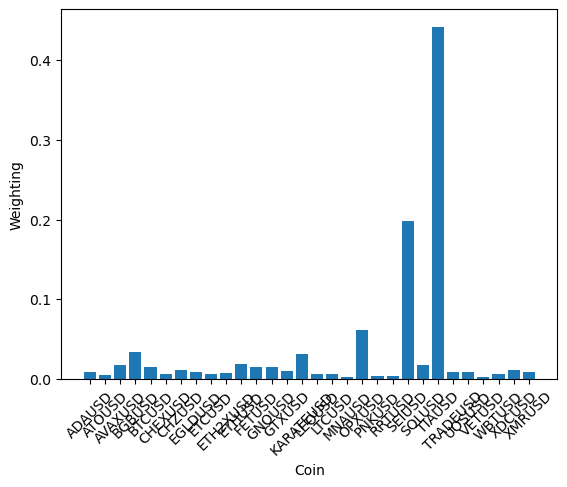

In [27]:
import matplotlib.pyplot as plt
# Calculates the efficient frontier of the basket of coins
ef = EfficientFrontier(mu, S,weight_bounds=(0,1))

# Calculates a the portfolio of the coins with the highest Sharpe ratio
weights = ef.max_sharpe()

weights_dict=dict(weights)

# Data to plot
labels = []
sizes = []

for x, y in weights_dict.items():
    if y > 0:
        labels.append(x)
        sizes.append(y)

# Plot
plt.xticks(rotation=45)
plt.xlabel('Coin')
plt.ylabel('Weighting')
plt.bar(x=labels,height=sizes,)


In [23]:
# # Function that rounds off the weights and eliminates any near-zero weights
# cleaned_weights = ef.clean_weights()
# ef.save_weights_to_file("weights.txt")  # saves to file
# print(cleaned_weights)

In [24]:
# ef.portfolio_performance(verbose=True)

In [25]:
ef = EfficientFrontier(mu, S)
ef.add_objective(objective_functions.L2_reg, gamma=0.1)
w = ef.max_sharpe()
print(ef.clean_weights())

OrderedDict([('ADAUSD', 0.0091), ('ATOUSD', 0.00496), ('AVAXUSD', 0.01821), ('BGBUSD', 0.03398), ('BTCUSD', 0.01467), ('CHEXUSD', 0.00626), ('CHZUSD', 0.01099), ('EGLDUSD', 0.00926), ('ETCUSD', 0.00688), ('ETH2XUSD', 0.00718), ('ETHUSD', 0.01888), ('FETUSD', 0.01462), ('GNOUSD', 0.015), ('GTXUSD', 0.00976), ('KARATEUSD', 0.03199), ('LEOUSD', 0.00623), ('LTCUSD', 0.00623), ('MNAUSD', 0.00212), ('OPXUSD', 0.06117), ('PNKUSD', 0.00414), ('RRTUSD', 0.00355), ('SEIUSD', 0.19796), ('SOLUSD', 0.01764), ('TIAUSD', 0.4416), ('TRADEUSD', 0.00904), ('UOSUSD', 0.00903), ('VETUSD', 0.00284), ('WBTUSD', 0.0066), ('XDCUSD', 0.01187), ('XMRUSD', 0.00824)])


c:\Users\jason\mambaforge\envs\devenv\Lib\site-packages\pypfopt\efficient_frontier\efficient_frontier.py:259: UserWarning:

max_sharpe transforms the optimization problem so additional objectives may not work as expected.



In [26]:
latest_prices = get_latest_prices(df)
da = DiscreteAllocation(w, latest_prices, total_portfolio_value=1000000)
allocation, leftover = da.lp_portfolio()
print("Here are the number of each coin to purchase:",allocation)
ef.portfolio_performance(verbose=True)
print("leftover:",leftover)

dollars_per_coin={}
for each in allocation:
    dollars_per_coin[each]=allocation[each]*latest_prices[each]
print("Here are the number of dollars spent on each coin: ")
print(dollars_per_coin)

Here are the number of each coin to purchase: {'ADAUSD': 15582, 'ATOUSD': 482, 'AVAXUSD': 495, 'BGBUSD': 33681, 'CHEXUSD': 64856, 'CHZUSD': 87133, 'EGLDUSD': 162, 'ETCUSD': 257, 'ETH2XUSD': 2, 'ETHUSD': 6, 'FETUSD': 12843, 'GNOUSD': 43, 'GTXUSD': 1981, 'KARATEUSD': 7023190, 'LEOUSD': 1468, 'LTCUSD': 89, 'MNAUSD': 4199, 'OPXUSD': 16136, 'PNKUSD': 183672, 'RRTUSD': 4615, 'SEIUSD': 239782, 'SOLUSD': 171, 'TIAUSD': 26046, 'TRADEUSD': 8750, 'UOSUSD': 30228, 'VETUSD': 62757, 'XDCUSD': 291817, 'XMRUSD': 66}
Expected annual return: 783.7%
Annual volatility: 265.9%
Sharpe Ratio: 2.94
leftover: 22651.322529135272
here are the number of dollars spent on each coin
{'ADAUSD': 9102.69276, 'ATOUSD': 4963.636, 'AVAXUSD': 18222.93, 'BGBUSD': 33980.760899999994, 'CHEXUSD': 6263.0142080000005, 'CHZUSD': 10987.4713, 'EGLDUSD': 9250.524, 'ETCUSD': 6887.6, 'ETH2XUSD': 6114.4, 'ETHUSD': 18339.0, 'FETUSD': 14620.471200000002, 'GNOUSD': 15145.890000000001, 'GTXUSD': 9765.3395, 'KARATEUSD': 31991.332769, 'LEOUS

c:\Users\jason\mambaforge\envs\devenv\Lib\site-packages\cvxpy\problems\problem.py:1403: UserWarning:

Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.

